<a href="https://colab.research.google.com/github/ga642381/ML2021-Spring/blob/main/HW06/HW06.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Homework 6 - Generative Adversarial Network**

This is the example code of homework 6 of the machine learning course by Prof. Hung-yi Lee.


In this homework, you are required to build a generative adversarial  network for anime face generation.


## Set up the environment


### Packages Installation

In [27]:
# You may replace the workspace directory if you want.
workspace_dir = ''

# Training progress bar
#!pip install -q qqdm

### Download the dataset
**Please use the link according to the last digit of your student ID first!**

If all download links fail, please follow [here](https://drive.google.com/drive/folders/13T0Pa_WGgQxNkqZk781qhc5T9-zfh19e).

* To open the file using your browser, use the link below (replace the id first!):
https://drive.google.com/file/d/REPLACE_WITH_ID
* e.g. https://drive.google.com/file/d/1IGrTr308mGAaCKotpkkm8wTKlWs9Jq-p

In [28]:
#!gdown --id 1IGrTr308mGAaCKotpkkm8wTKlWs9Jq-p --output "{workspace_dir}/crypko_data.zip"

# Other download links
#   Please uncomment the line according to the last digit of your student ID first

# 0
# !gdown --id 131zPaVoi-U--XThvzgRfaxrumc3YSBd3 --output "{workspace_dir}/crypko_data.zip"

# 1
# !gdown --id 1kCuIj1Pf3T2O94H9bUBxjPBKb---WOmH --output "{workspace_dir}/crypko_data.zip"

# 2
# !gdown --id 1boEoiiqBJwoHVvjmI0xgoutE9G0Rv8CD --output "{workspace_dir}/crypko_data.zip"

# 3
# !gdown --id 1Ic0mktAQQvnNAnswrPHsg-u2OWGBXTWF --output "{workspace_dir}/crypko_data.zip"

# 4
# !gdown --id 1PFcc25r9tLE7OyQ-CDadtysNdWizk6Yg --output "{workspace_dir}/crypko_data.zip"

# 5
# !gdown --id 1wgkrYkTrhwDSMdWa5NwpXeE4-7JaUuX2 --output "{workspace_dir}/crypko_data.zip"

# 6
# !gdown --id 19gwNYWi9gN9xVL86jC3v8qqNtrXyq5Bf --output "{workspace_dir}/crypko_data.zip"

# 7 
# !gdown --id 1-KPZB6frRSRLRAtQfafKCVA7em0_NrJG --output "{workspace_dir}/crypko_data.zip"

# 8
# !gdown --id 1rNBfmn0YBzXuG5ub7CXbsGwduZqEs8hx --output "{workspace_dir}/crypko_data.zip"

# 9
# !gdown --id 113NEISX-2j6rBd1yyBx0c3_9nPIzSNz- --output "{workspace_dir}/crypko_data.zip"


###Unzip the downloaded file.
The unzipped tree structure is like 
```
faces/
├── 1.jpg
├── 2.jpg
├── 3.jpg
...
```

In [29]:
#!unzip -q "{workspace_dir}/crypko_data.zip" -d "{workspace_dir}/"

## Random seed
Set the random seed to a certain value for reproducibility.

In [30]:
import random

import torch
import numpy as np


def same_seeds(seed):
    # Python built-in random module
    random.seed(seed)
    # Numpy
    np.random.seed(seed)
    # Torch
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed(seed)
        torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.benchmark = False
    torch.backends.cudnn.deterministic = True

same_seeds(2021)

## Import Packages
First, we need to import packages that will be used later.

Like hw3, we highly rely on **torchvision**, a library of PyTorch.

In [31]:
import os
import glob

import torch.nn as nn
import torch.nn.functional as F
import torchvision
import torchvision.transforms as transforms
from torch import optim
from torch.autograd import Variable
from torch.utils.data import Dataset, DataLoader
import matplotlib.pyplot as plt
from qqdm.notebook import qqdm

## Dataset
1. Resize the images to (64, 64)
1. Linearly map the values from [0, 1] to  [-1, 1].

Please refer to [PyTorch official website](https://pytorch.org/vision/stable/transforms.html) for details about different transforms.


In [32]:
class CrypkoDataset(Dataset):
    def __init__(self, fnames, transform):
        self.transform = transform
        self.fnames = fnames
        self.num_samples = len(self.fnames)

    def __getitem__(self,idx):
        fname = self.fnames[idx]
        # 1. Load the image
        img = torchvision.io.read_image(fname)
        # 2. Resize and normalize the images using torchvision.
        img = self.transform(img)
        return img

    def __len__(self):
        return self.num_samples


def get_dataset(root):
    fnames = glob.glob(os.path.join(root, '*'))
    # 1. Resize the image to (64, 64)
    # 2. Linearly map [0, 1] to [-1, 1]
    compose = [
        transforms.ToPILImage(),
        transforms.Resize((64, 64)),
        transforms.ToTensor(),
        transforms.Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5)),
    ]
    transform = transforms.Compose(compose)
    dataset = CrypkoDataset(fnames, transform)
    return dataset

### Show some images
Note that the values are in the range of [-1, 1], we should shift them to the valid range, [0, 1], to display correctly.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


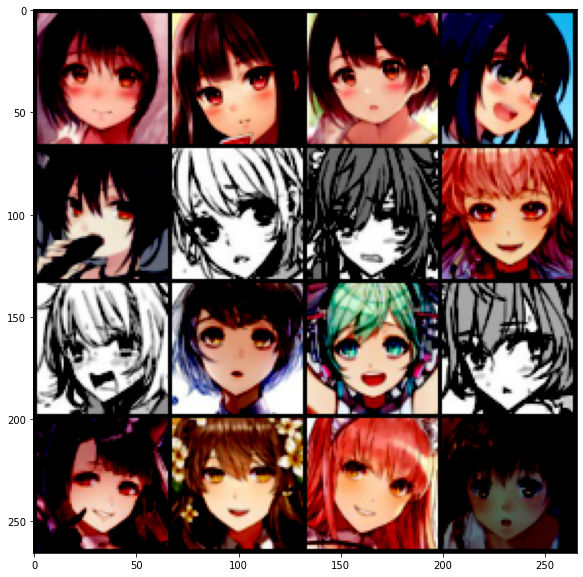

In [33]:
dataset = get_dataset(os.path.join(workspace_dir, 'faces'))

images = [dataset[i] for i in range(16)]
grid_img = torchvision.utils.make_grid(images, nrow=4)
plt.figure(figsize=(10,10))
plt.imshow(grid_img.permute(1, 2, 0))
plt.show()

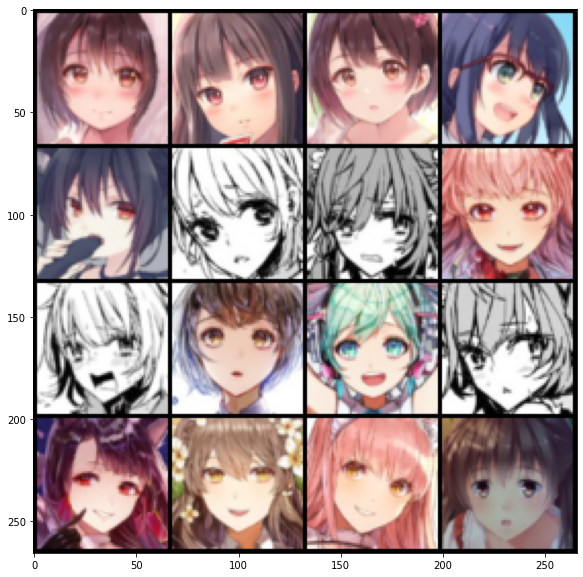

In [34]:
images = [(dataset[i]+1)/2 for i in range(16)]
grid_img = torchvision.utils.make_grid(images, nrow=4)
plt.figure(figsize=(10,10))
plt.imshow(grid_img.permute(1, 2, 0))
plt.show()

## Model
Here, we use DCGAN as the model structure. Feel free to modify your own model structure.

Note that the `N` of the input/output shape stands for the batch size.

In [35]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)

class Generator(nn.Module):
    """
    Input shape: (N, in_dim)
    Output shape: (N, 3, 64, 64)
    """
    def __init__(self, in_dim, dim=64):
        super(Generator, self).__init__()
        def dconv_bn_relu(in_dim, out_dim):
            return nn.Sequential(
                #逆卷积
                nn.ConvTranspose2d(in_dim, out_dim, 5, 2,
                                   padding=2, output_padding=1, bias=False),
                nn.BatchNorm2d(out_dim),
                nn.ReLU()
            )
        self.l1 = nn.Sequential(
            nn.Linear(in_dim, dim * 8 * 4 * 4, bias=False),
            nn.BatchNorm1d(dim * 8 * 4 * 4),
            nn.ReLU()
        )
        self.l2_5 = nn.Sequential(
            dconv_bn_relu(dim * 8, dim * 4),
            dconv_bn_relu(dim * 4, dim * 2),
            dconv_bn_relu(dim * 2, dim),
            nn.ConvTranspose2d(dim, 3, 5, 2, padding=2, output_padding=1),
            nn.Tanh()
        )
        self.apply(weights_init)

    def forward(self, x):
        y = self.l1(x)
        y = y.view(y.size(0), -1, 4, 4)#reshape (N,dim*8,4,4)
        y = self.l2_5(y)
        return y


class Discriminator(nn.Module):
    """
    Input shape: (N, 3, 64, 64)
    Output shape: (N, )
    """
    def __init__(self, in_dim, dim=64):
        super(Discriminator, self).__init__()

        def conv_bn_lrelu(in_dim, out_dim):
            return nn.Sequential(
                nn.Conv2d(in_dim, out_dim, 5, 2, 2),
                nn.BatchNorm2d(out_dim),
                nn.LeakyReLU(0.2),
            )
            
        """ Medium: Remove the last sigmoid layer for WGAN. """
        self.ls = nn.Sequential(
            nn.Conv2d(in_dim, dim, 5, 2, 2), 
            nn.LeakyReLU(0.2),
            conv_bn_lrelu(dim, dim * 2),
            conv_bn_lrelu(dim * 2, dim * 4),
            conv_bn_lrelu(dim * 4, dim * 8),
            nn.Conv2d(dim * 8, 1, 4),
            #nn.Sigmoid(), 
        )
        self.apply(weights_init)
        
    def forward(self, x):
        y = self.ls(x)
        y = y.view(-1)
        return y

## Training

### Initialization
- hyperparameters
- model
- optimizer
- dataloader

In [36]:
# Training hyperparameters
batch_size = 64
z_dim = 100
z_sample = Variable(torch.randn(100, z_dim)).cuda()
lr = 1e-4

""" Medium: WGAN, 50 epoch, n_critic=5, clip_value=0.01 """
n_epoch = 50 # 50
n_critic = 5 # 5
clip_value = 0.01

log_dir = os.path.join(workspace_dir, 'logs')
ckpt_dir = os.path.join(workspace_dir, 'checkpoints')
os.makedirs(log_dir, exist_ok=True)
os.makedirs(ckpt_dir, exist_ok=True)

# Model
G = Generator(in_dim=z_dim).cuda()
D = Discriminator(3).cuda()
G.train()
D.train()

# Loss
criterion = nn.BCELoss()

""" Medium: Use RMSprop for WGAN. """
# Optimizer
#opt_D = torch.optim.Adam(D.parameters(), lr=lr, betas=(0.5, 0.999))
#opt_G = torch.optim.Adam(G.parameters(), lr=lr, betas=(0.5, 0.999))
opt_D = torch.optim.RMSprop(D.parameters(), lr=lr)
opt_G = torch.optim.RMSprop(G.parameters(), lr=lr)


# DataLoader
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=0)


### Training loop
We store some pictures regularly to monitor the current performance of the Generator, and regularly record checkpoints.

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:28<00:00:00  7.51it/s  -1.4172  0.7338    1    1115                                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_001.jpg.


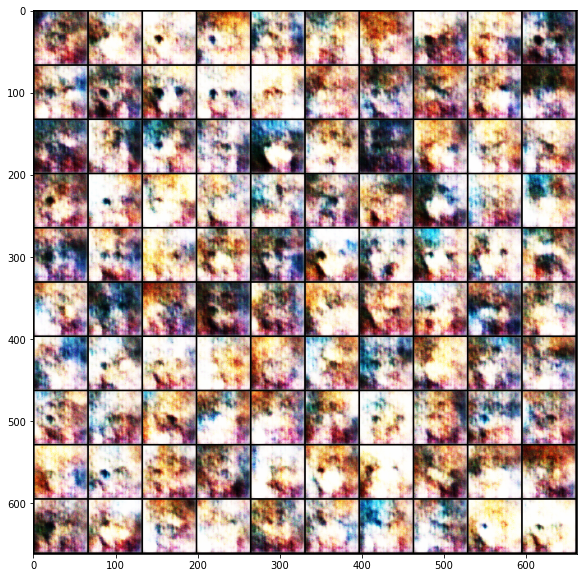

   Iters      Elapsed Time      Speed    Loss_D  Loss_G  Epoch  Step                                                    
 1115/1115  00:01:59<00:00:00  9.34it/s  -1.08   0.7038    2    2230                                                    

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_002.jpg.


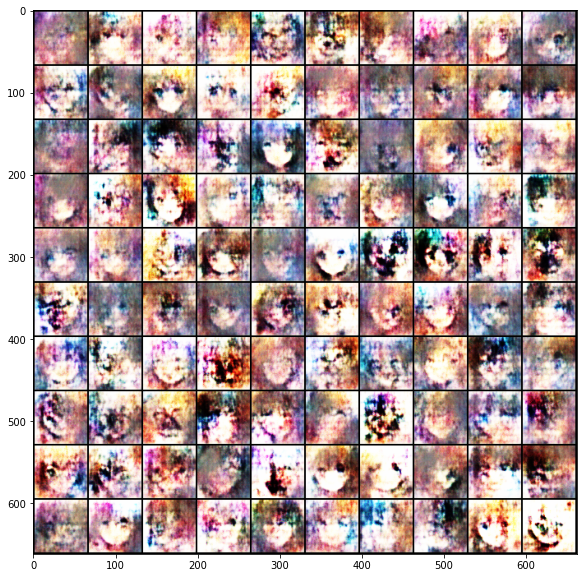

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:01:59<00:00:00  9.35it/s  -1.2341  0.7086    3    3345                                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_003.jpg.


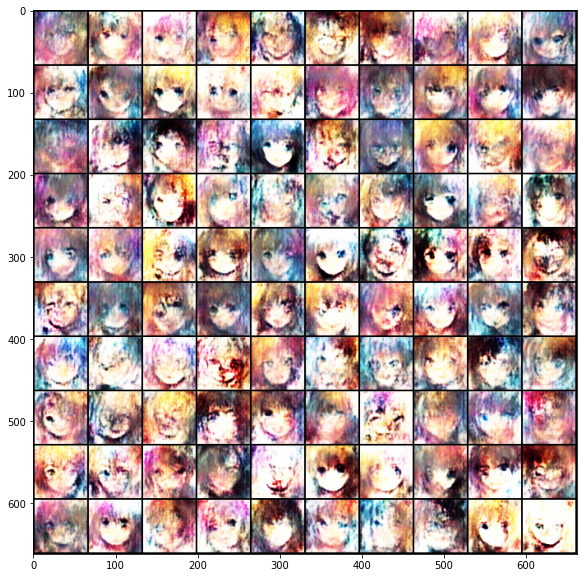

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:01:59<00:00:00  9.33it/s  -1.4713  0.7479    4    4460                                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_004.jpg.


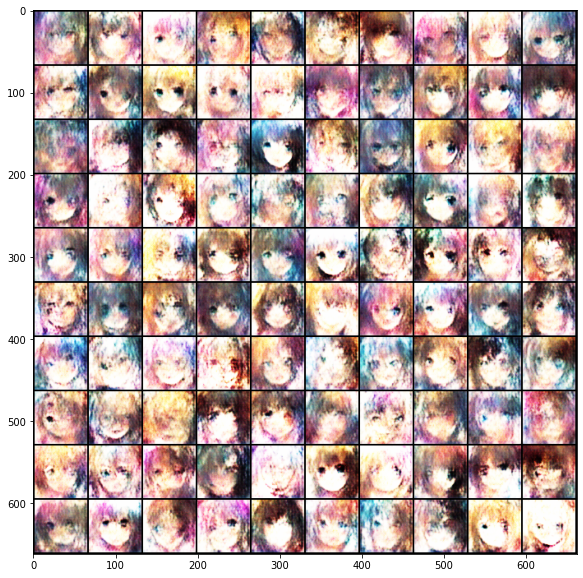

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:00<00:00:00  9.28it/s  -1.4968  0.7613    5    5575                                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_005.jpg.


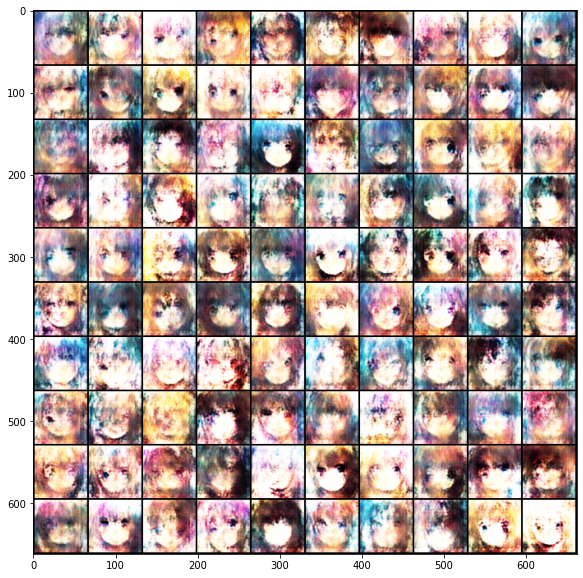

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:00<00:00:00  9.27it/s  -1.4197  0.7364    6    6690                                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_006.jpg.


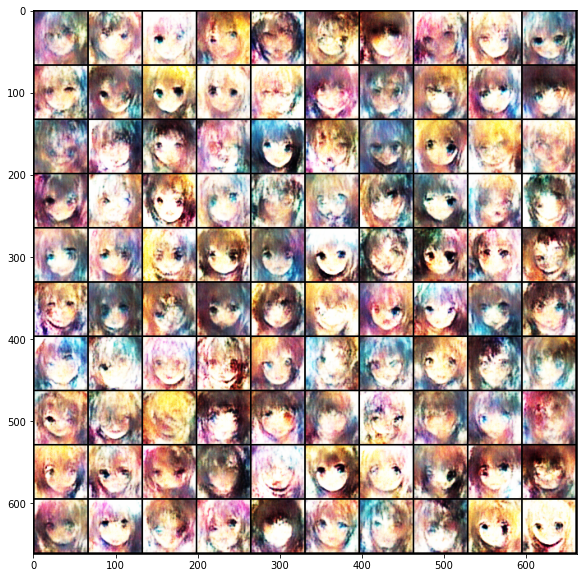

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:01:59<00:00:00  9.29it/s  -1.4335  0.7374    7    7805                                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_007.jpg.


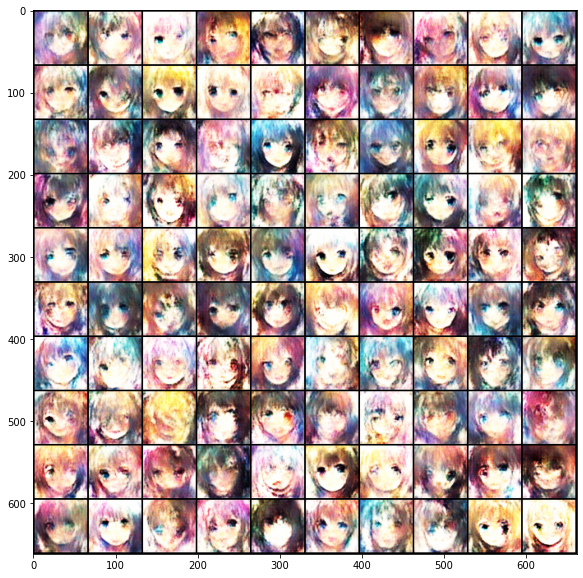

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:00<00:00:00  9.28it/s  -1.4421  0.7391    8    8920                                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_008.jpg.


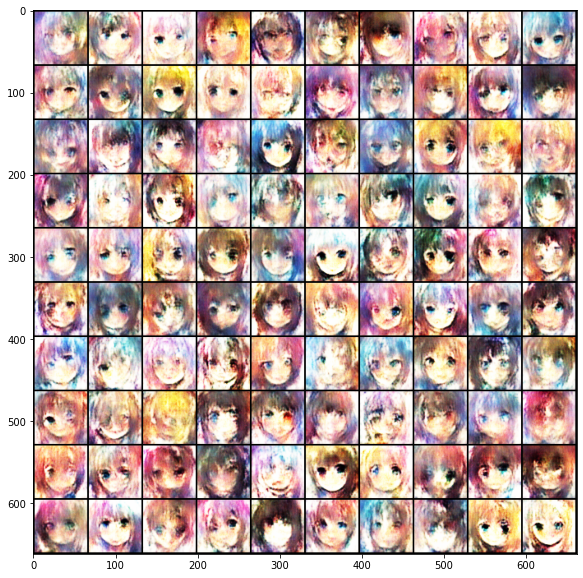

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:01:59<00:00:00  9.29it/s  -1.2795  0.721     9    10035                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_009.jpg.


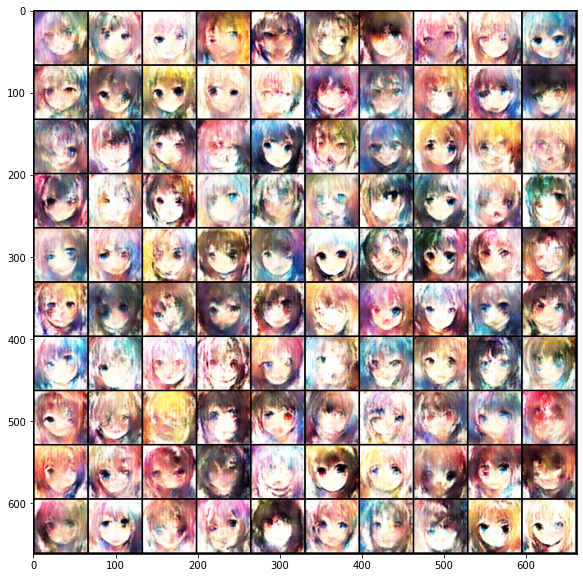

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:00<00:00:00  9.29it/s  -0.7948  0.5129   10    11150                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_010.jpg.


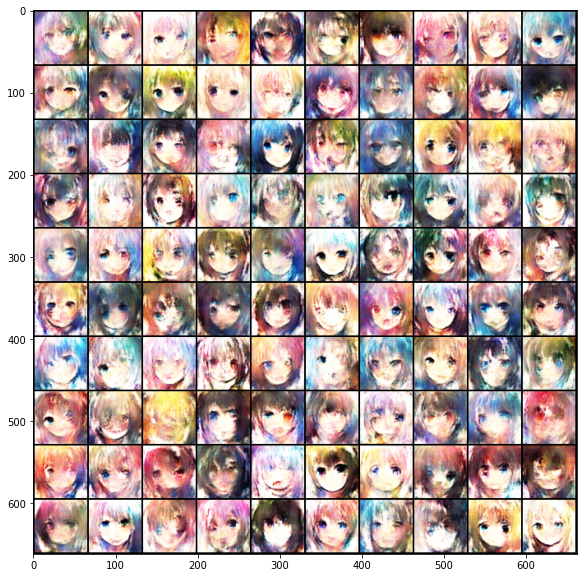

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:00<00:00:00  9.29it/s  -1.3422  0.3983   11    12265                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_011.jpg.


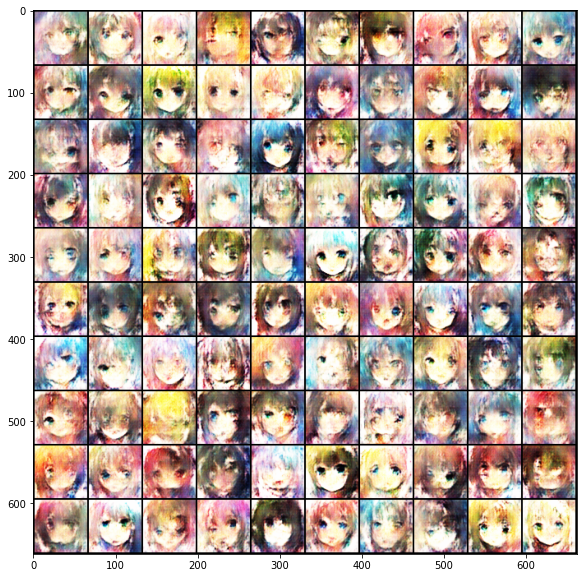

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:00<00:00:00  9.27it/s  -1.3643  0.7011   12    13380                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_012.jpg.


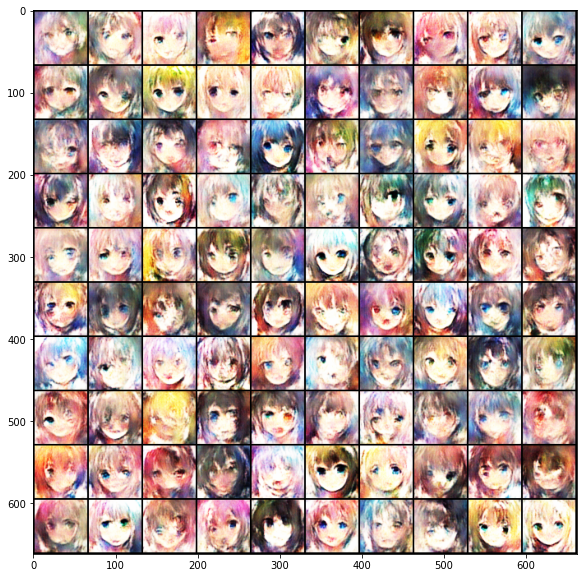

   Iters      Elapsed Time      Speed    Loss_D  Loss_G  Epoch  Step                                                    
 1115/1115  00:02:00<00:00:00  9.25it/s  -1.405  0.6914   13    14495                                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_013.jpg.


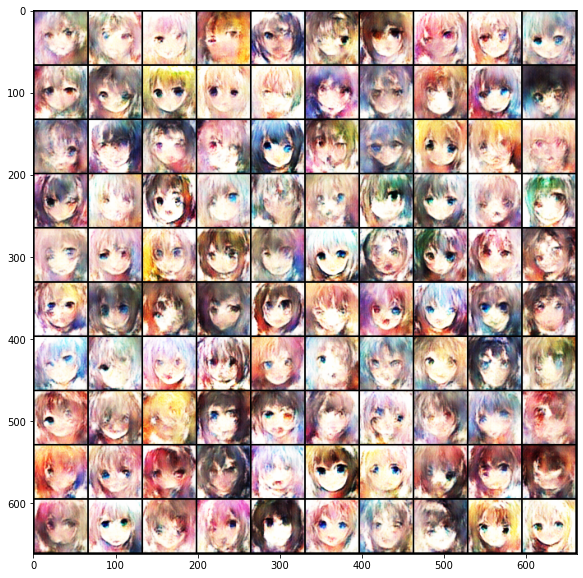

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:03<00:00:00  9.05it/s  -1.3608  0.698    14    15610                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_014.jpg.


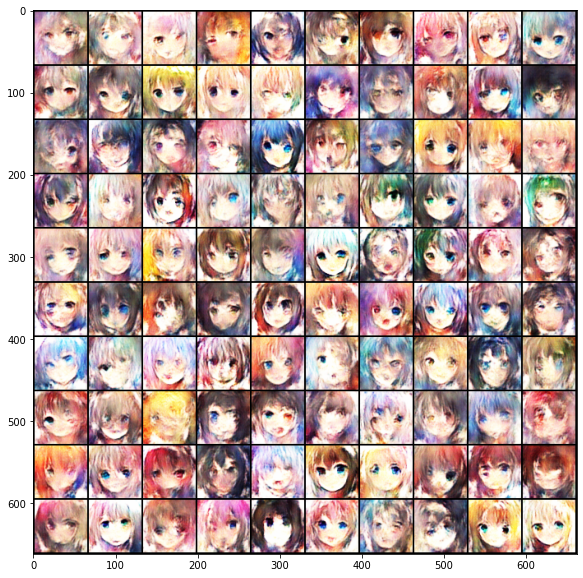

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:01<00:00:00  9.15it/s  -1.0289  0.5077   15    16725                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_015.jpg.


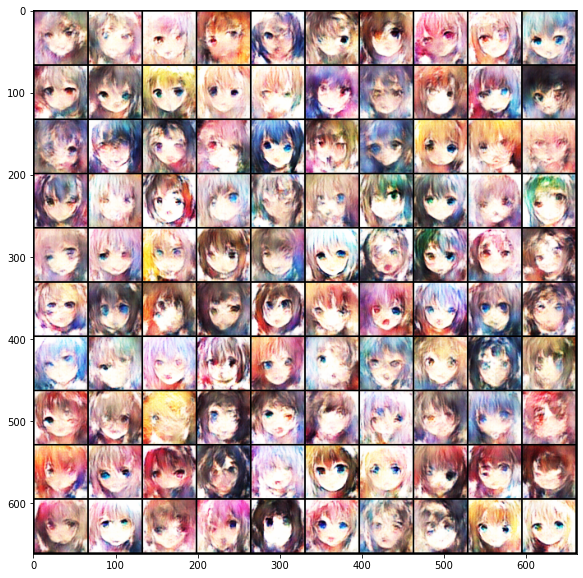

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:02<00:00:00  9.13it/s  -0.8754  0.5622   16    17840                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_016.jpg.


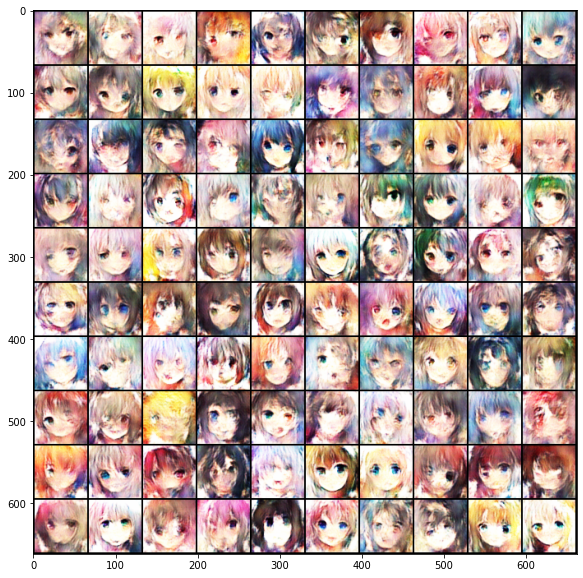

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:01<00:00:00  9.17it/s  -0.9431  0.6776   17    18955                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_017.jpg.


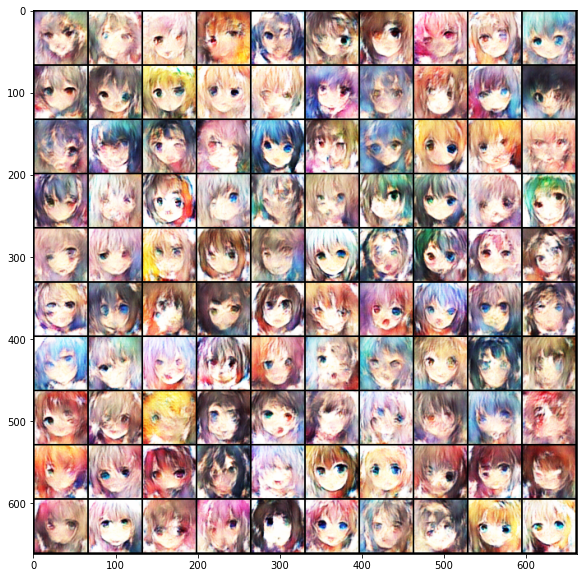

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:02<00:00:00  9.12it/s  -1.2229  0.7184   18    20070                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_018.jpg.


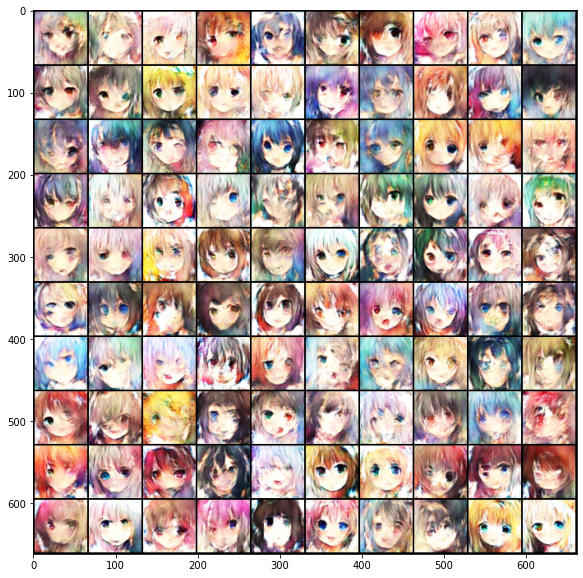

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:01<00:00:00  9.16it/s  -0.9601  0.295    19    21185                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_019.jpg.


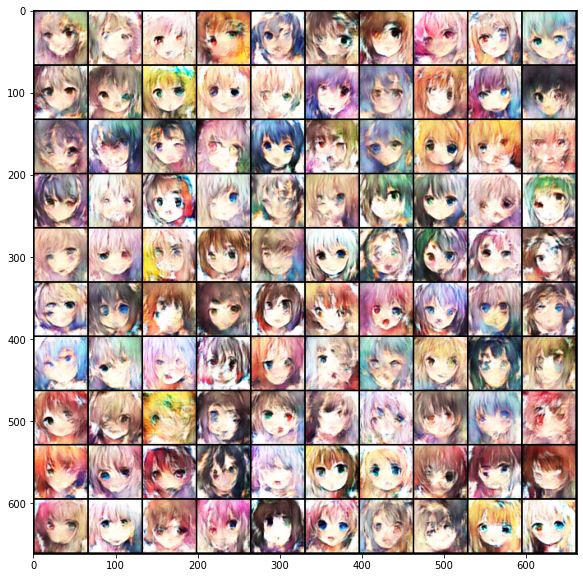

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:02<00:00:00  9.14it/s  -1.2285  0.6527   20    22300                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_020.jpg.


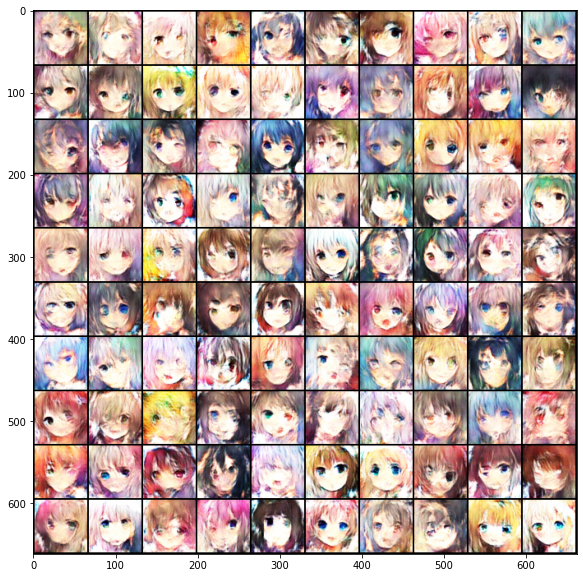

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:01<00:00:00  9.16it/s  -1.2472  0.6394   21    23415                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_021.jpg.


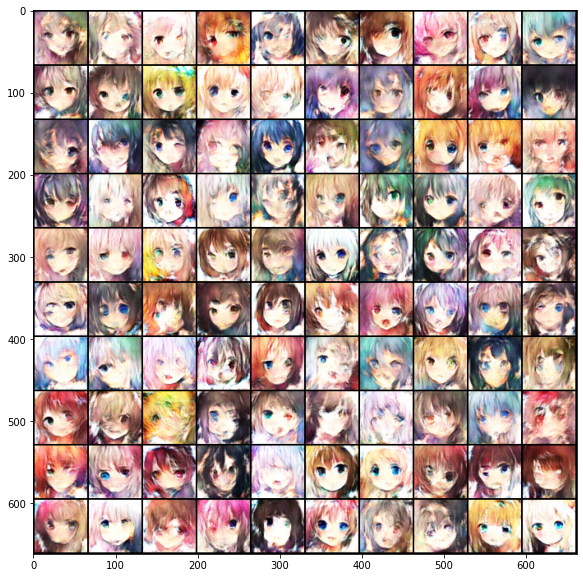

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:01<00:00:00  9.19it/s  -0.8972  0.3101   22    24530                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_022.jpg.


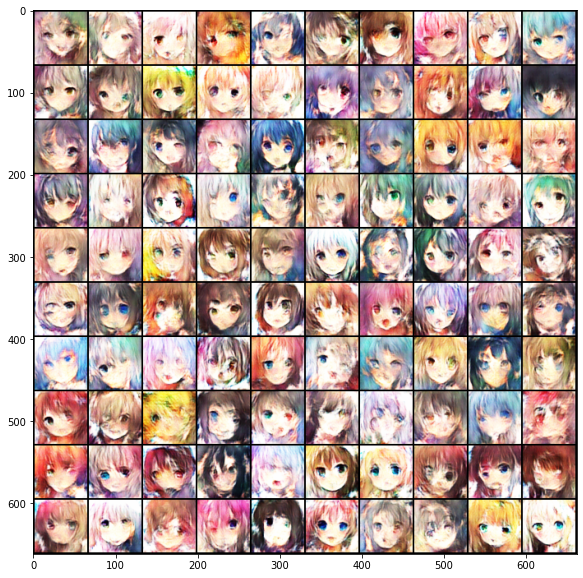

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:01<00:00:00  9.15it/s  -0.7374  0.693    23    25645                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_023.jpg.


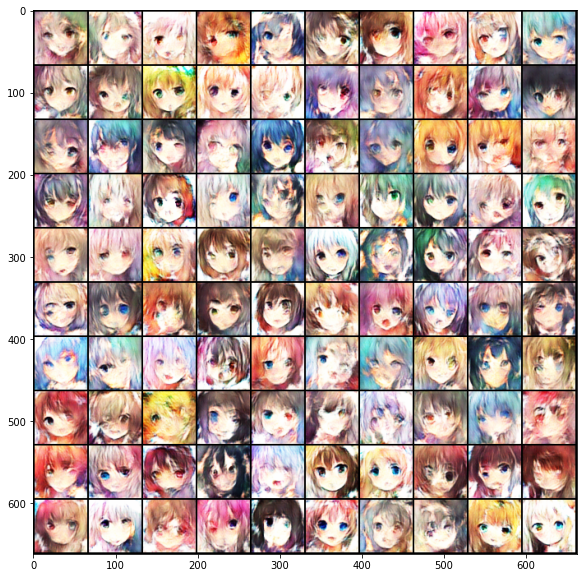

   Iters      Elapsed Time      Speed    Loss_D  Loss_G  Epoch  Step                                                    
 1115/1115  00:02:02<00:00:00  9.13it/s  -1.111  0.6768   24    26760                                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_024.jpg.


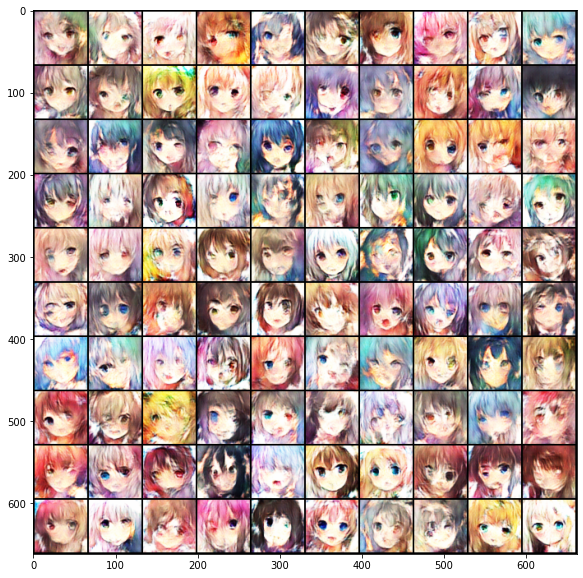

   Iters      Elapsed Time      Speed    Loss_D  Loss_G  Epoch  Step                                                    
 1115/1115  00:02:01<00:00:00  9.16it/s  -0.978  0.6369   25    27875                                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_025.jpg.


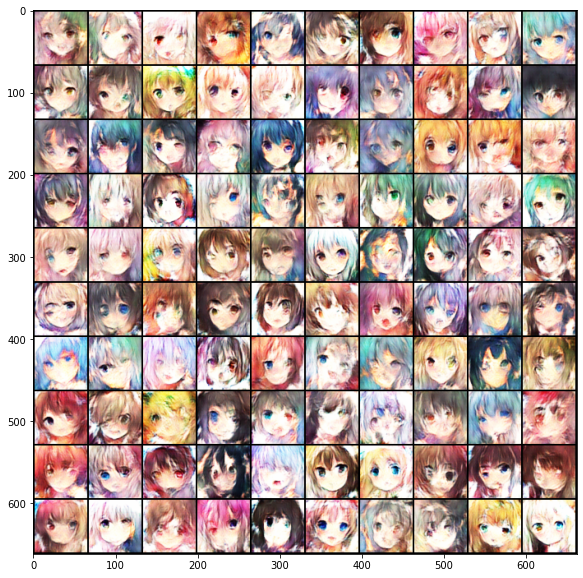

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:01<00:00:00  9.14it/s  -0.9876  0.6782   26    28990                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_026.jpg.


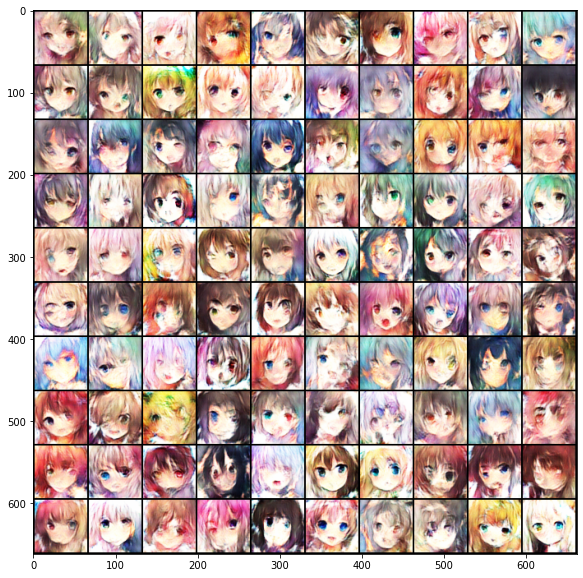

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:01<00:00:00  9.17it/s  -0.7596  0.4404   27    30105                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_027.jpg.


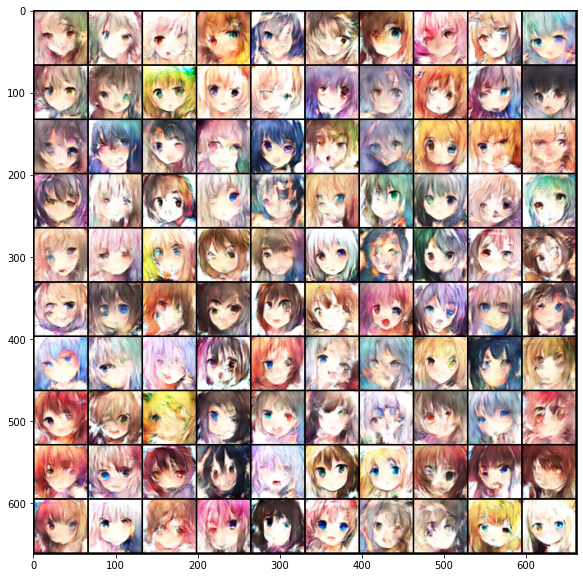

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:01<00:00:00  9.17it/s  -0.8015  0.1475   28    31220                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_028.jpg.


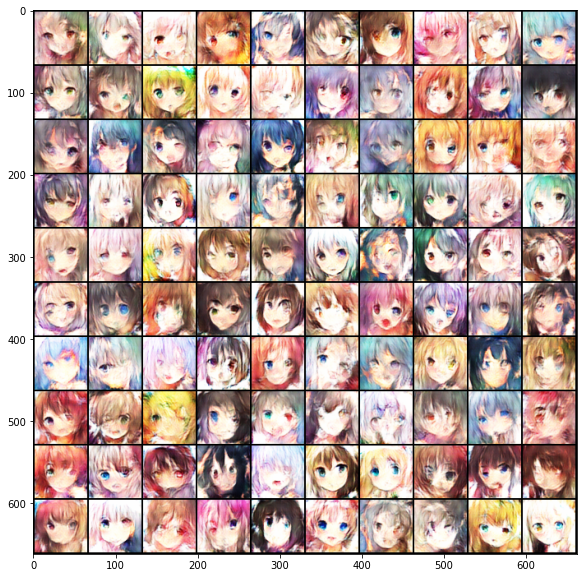

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:01<00:00:00  9.16it/s  -0.8411  0.4446   29    32335                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_029.jpg.


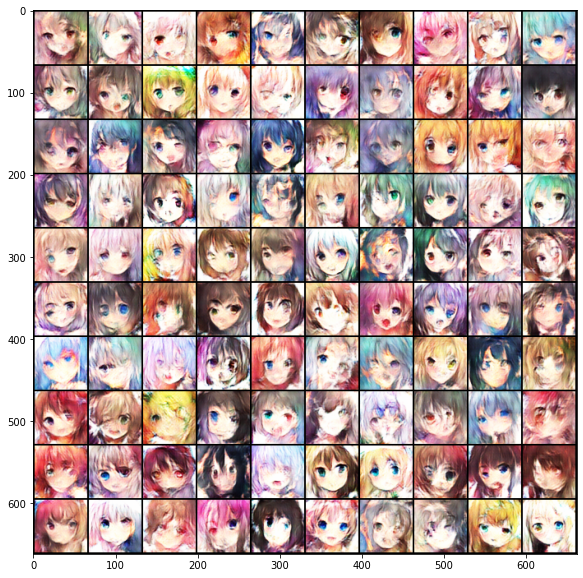

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:02<00:00:00  9.11it/s  -0.7166  0.4279   30    33450                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_030.jpg.


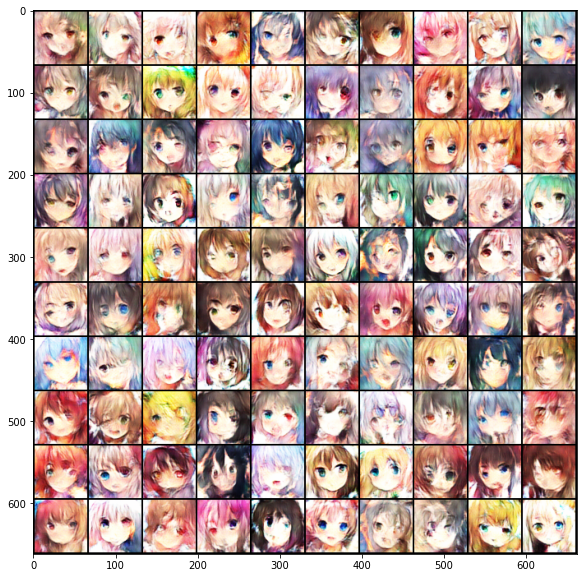

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:03<00:00:00  9.04it/s  -1.0301  0.6296   31    34565                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_031.jpg.


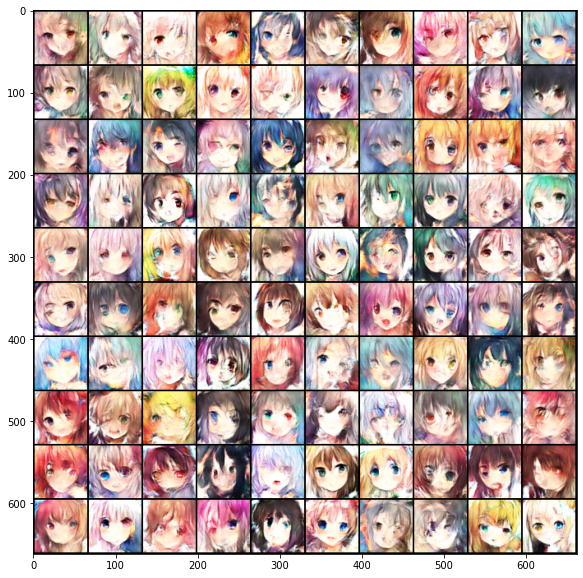

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:02<00:00:00  9.12it/s  -0.4955  0.5476   32    35680                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_032.jpg.


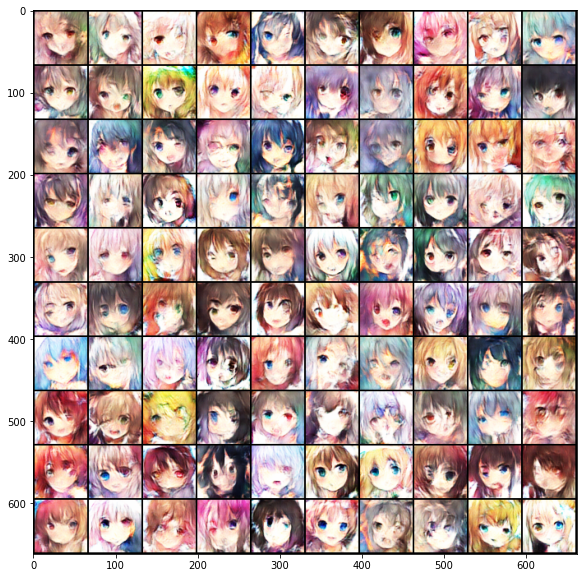

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:02<00:00:00  9.13it/s  -0.9272  0.4167   33    36795                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_033.jpg.


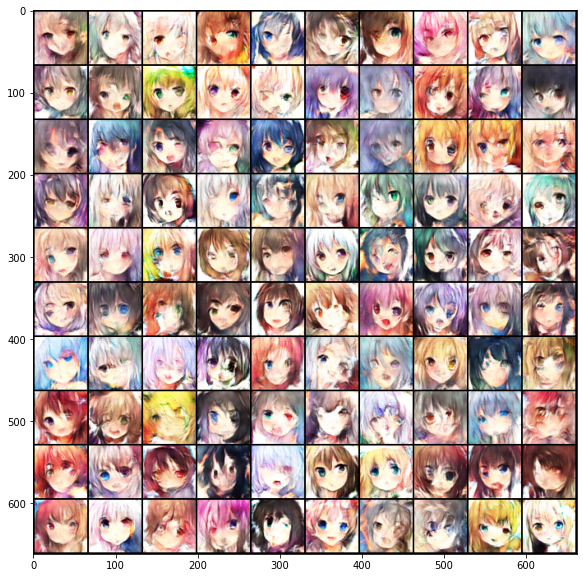

   Iters      Elapsed Time      Speed    Loss_D  Loss_G  Epoch  Step                                                    
 1115/1115  00:02:02<00:00:00  9.11it/s  -0.623  0.5861   34    37910                                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_034.jpg.


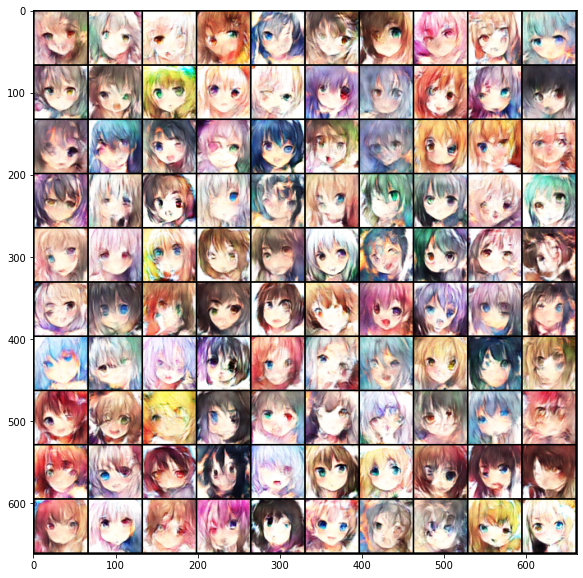

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:01<00:00:00  9.14it/s  -1.0668  0.5929   35    39025                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_035.jpg.


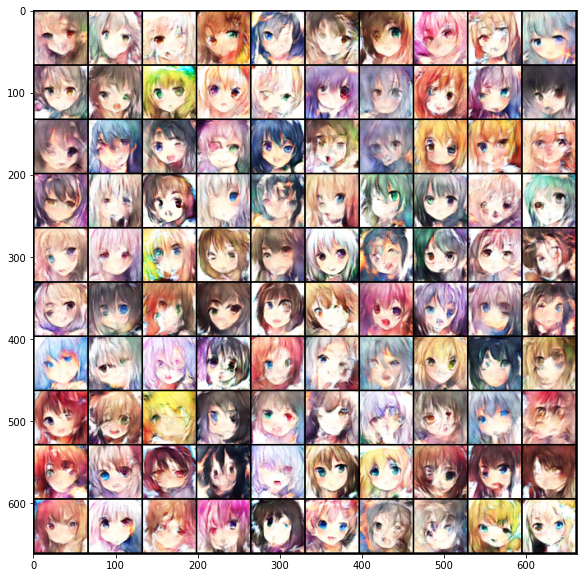

   Iters      Elapsed Time      Speed    Loss_D  Loss_G  Epoch  Step                                                    
 1115/1115  00:02:01<00:00:00  9.16it/s  -0.75   0.2018   36    40140                                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_036.jpg.


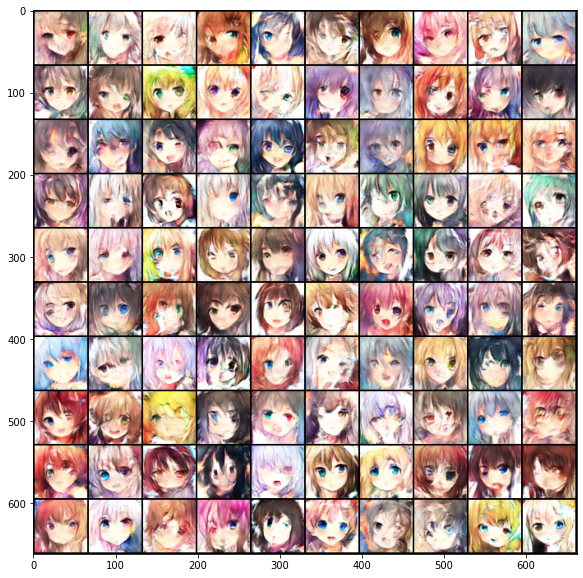

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:01<00:00:00  9.16it/s  -0.7332  0.5857   37    41255                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_037.jpg.


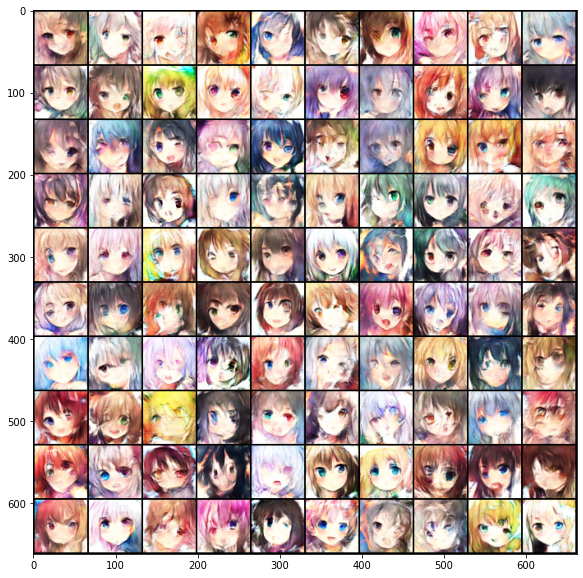

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:02<00:00:00  9.13it/s  -0.7828  0.6416   38    42370                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_038.jpg.


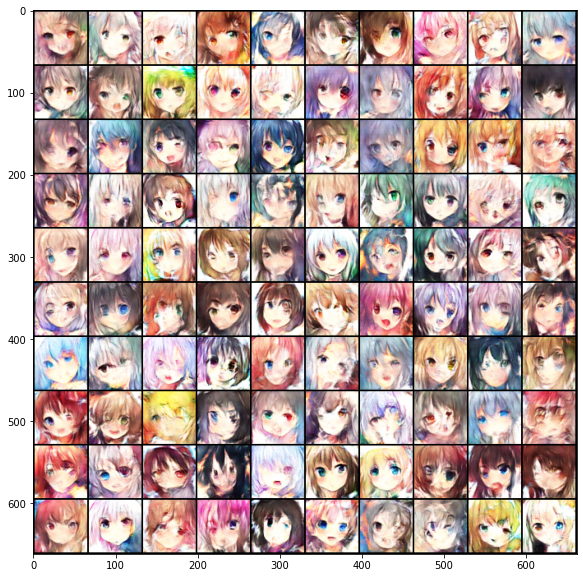

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:01<00:00:00  9.17it/s  -0.8401  0.5695   39    43485                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_039.jpg.


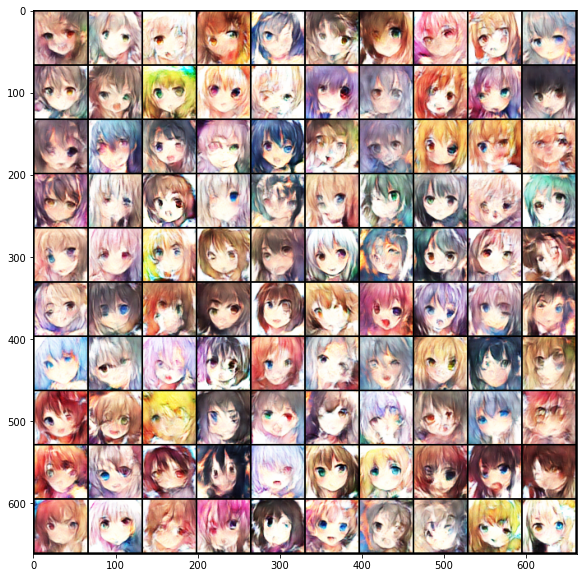

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:01<00:00:00  9.17it/s  -0.7367  0.2136   40    44600                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_040.jpg.


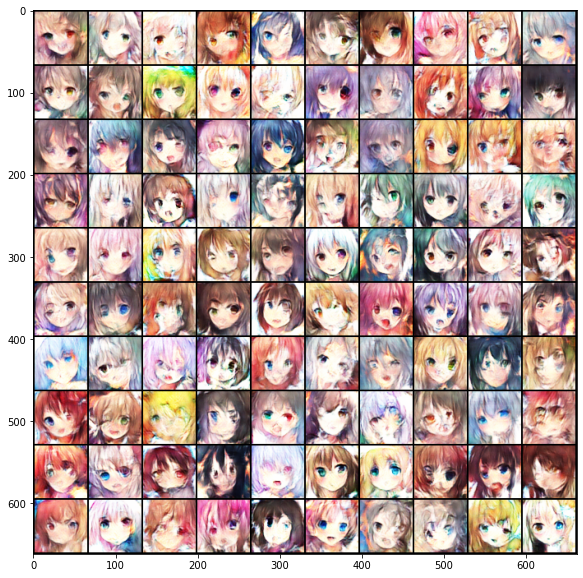

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:01<00:00:00  9.14it/s  -1.0442  0.463    41    45715                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_041.jpg.


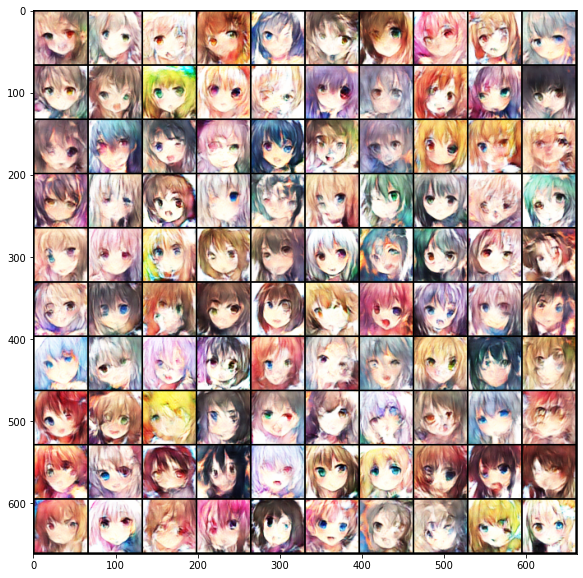

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:01<00:00:00  9.15it/s  -0.6578  0.6518   42    46830                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_042.jpg.


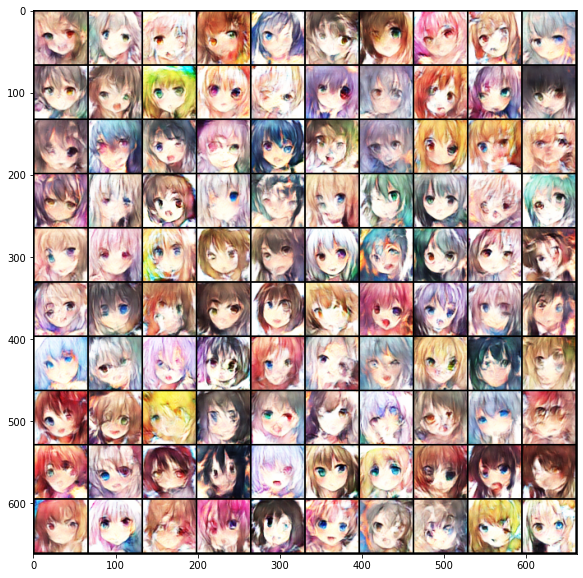

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:01<00:00:00  9.16it/s  -0.8242  0.6236   43    47945                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_043.jpg.


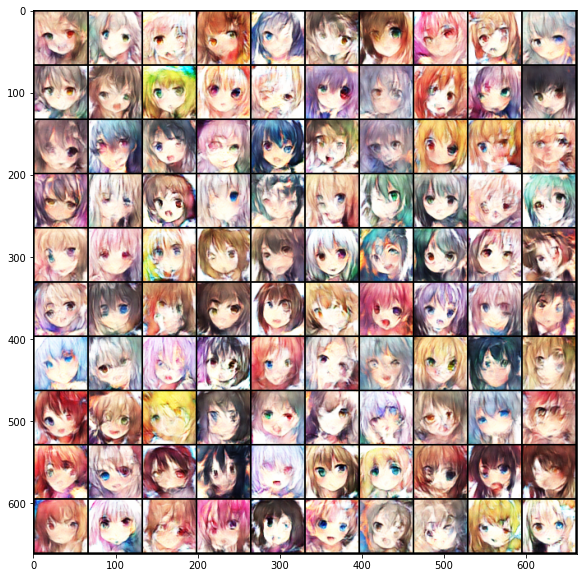

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:01<00:00:00  9.15it/s  -0.7316  0.6317   44    49060                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_044.jpg.


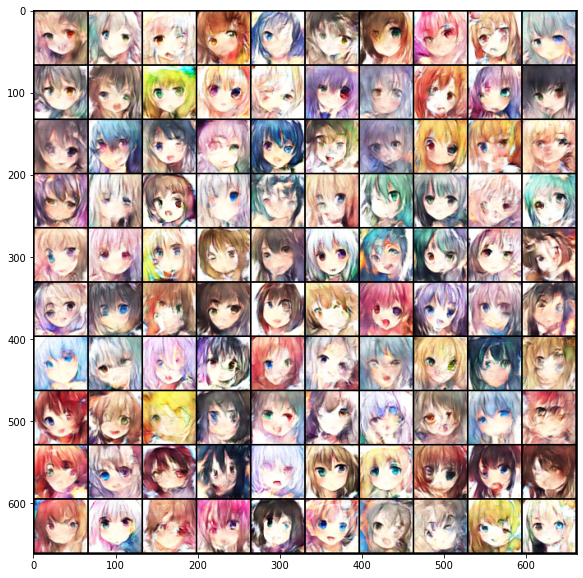

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:01<00:00:00  9.15it/s  -0.6337  0.6544   45    50175                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_045.jpg.


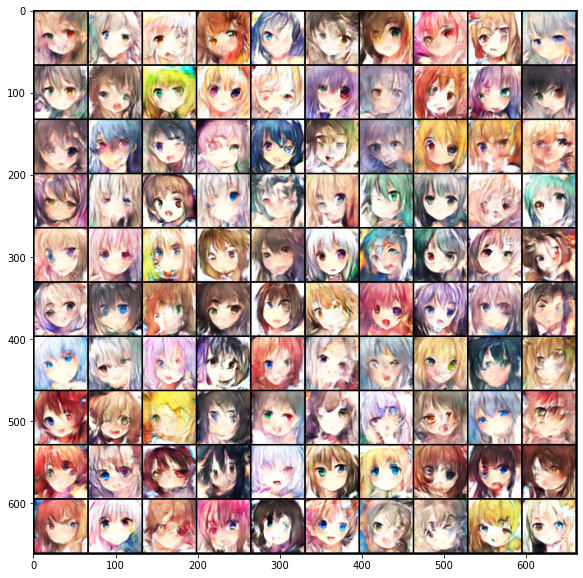

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:01<00:00:00  9.17it/s  -1.2126  0.6793   46    51290                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_046.jpg.


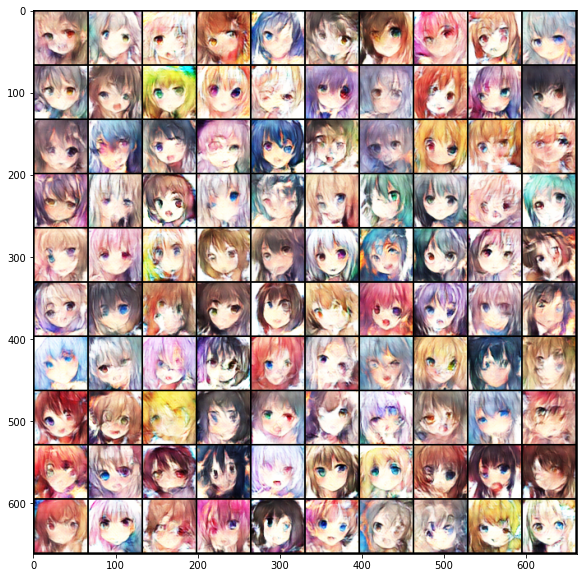

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:01<00:00:00  9.17it/s  -0.9133  0.1923   47    52405                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_047.jpg.


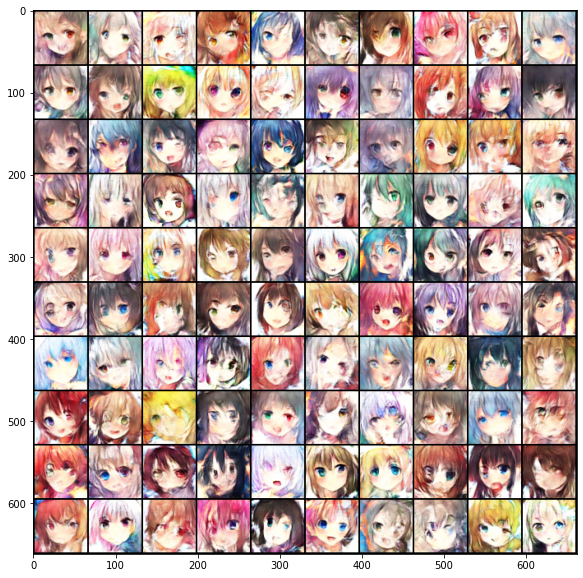

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:01<00:00:00  9.17it/s  -1.0397  0.6835   48    53520                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_048.jpg.


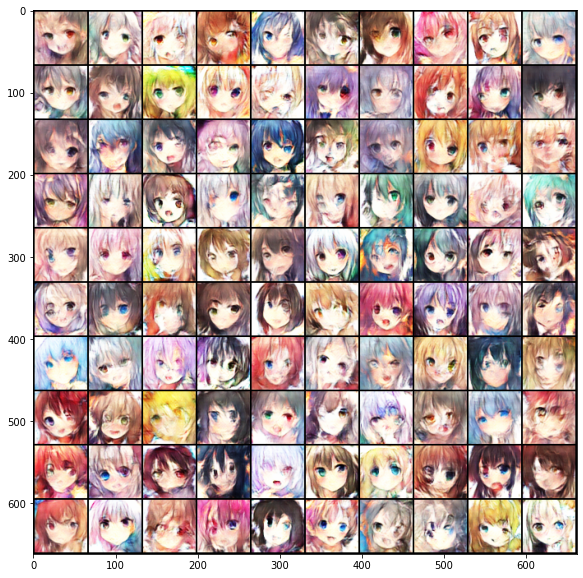

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:03<00:00:00  9.00it/s  -0.8697  0.6437   49    54635                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_049.jpg.


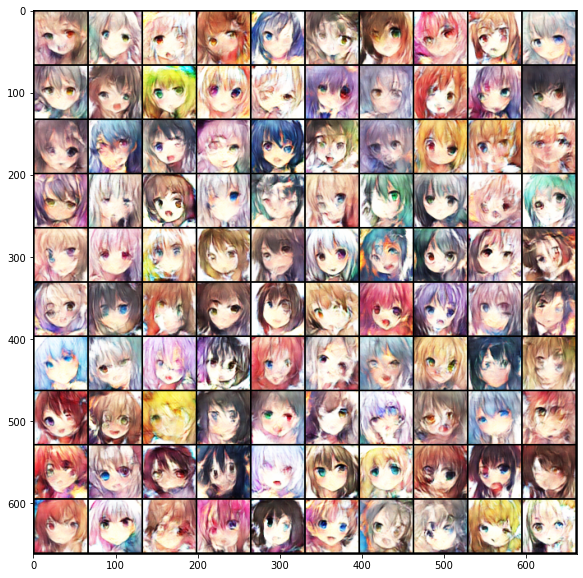

   Iters      Elapsed Time      Speed    Loss_D   Loss_G  Epoch  Step                                                   
 1115/1115  00:02:01<00:00:00  9.14it/s  -0.8394  0.6366   50    55750                                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

 | Save some samples to logs\Epoch_050.jpg.


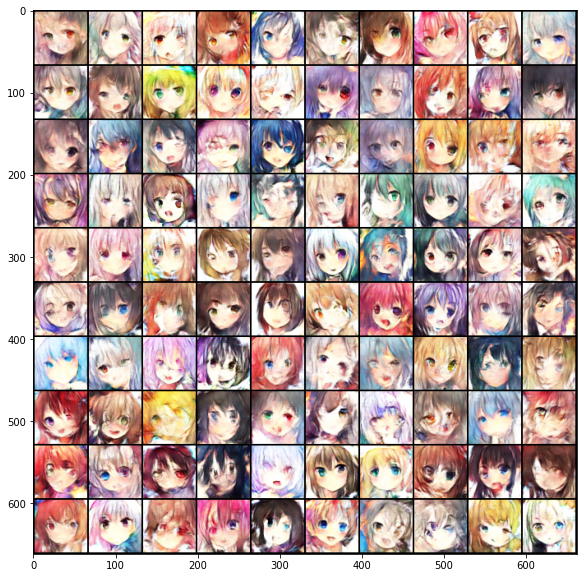

In [37]:
steps = 0
for e, epoch in enumerate(range(n_epoch)):
    progress_bar = qqdm(dataloader)
    for i, data in enumerate(progress_bar):
        imgs = data
        imgs = imgs.cuda()

        bs = imgs.size(0)

        # ============================================
        #  Train D
        # ============================================
        z = Variable(torch.randn(bs, z_dim)).cuda()
        r_imgs = Variable(imgs).cuda()#real image
        f_imgs = G(z) #generative image

        """ Medium: Use WGAN Loss. """
        # Label
        #r_label = torch.ones((bs)).cuda()
        #f_label = torch.zeros((bs)).cuda()

        # Model forwarding
        #r_logit = D(r_imgs.detach())
        #f_logit = D(f_imgs.detach())
        
        # Compute the loss for the discriminator.
        #r_loss = criterion(r_logit, r_label)
        #f_loss = criterion(f_logit, f_label)
        #loss_D = (r_loss + f_loss) / 2

        # WGAN Loss
        loss_D = -torch.mean(D(r_imgs)) + torch.mean(D(f_imgs))
       

        # Model backwarding
        D.zero_grad()
        loss_D.backward()

        # Update the discriminator.
        opt_D.step()

        """ Medium: Clip weights of discriminator. """
        for p in D.parameters():
            p.data.clamp_(-clip_value, clip_value)

        # ============================================
        #  Train G
        # ============================================
        if steps % n_critic == 0:  #train D n_critic times and G one time
            # Generate some fake images.
            z = Variable(torch.randn(bs, z_dim)).cuda()
            f_imgs = G(z)

            # Model forwarding
            f_logit = D(f_imgs)
            
            """ Medium: Use WGAN Loss"""
            # Compute the loss for the generator.
            #loss_G = criterion(f_logit, r_label)
            # WGAN Loss
            loss_G = -torch.mean(D(f_imgs))

            # Model backwarding
            G.zero_grad()
            loss_G.backward()

            # Update the generator.
            opt_G.step()

        steps += 1
        
        # Set the info of the progress bar
        #   Note that the value of the GAN loss is not directly related to
        #   the quality of the generated images.
        progress_bar.set_infos({
            'Loss_D': round(loss_D.item(), 4),
            'Loss_G': round(loss_G.item(), 4),
            'Epoch': e+1,
            'Step': steps,
        })

    G.eval()
    f_imgs_sample = (G(z_sample).data + 1) / 2.0
    filename = os.path.join(log_dir, f'Epoch_{epoch+1:03d}.jpg')
    torchvision.utils.save_image(f_imgs_sample, filename, nrow=10)
    print(f' | Save some samples to {filename}.')
    
    # Show generated images in the jupyter notebook.
    grid_img = torchvision.utils.make_grid(f_imgs_sample.cpu(), nrow=10)
    plt.figure(figsize=(10,10))
    plt.imshow(grid_img.permute(1, 2, 0))
    plt.show()
    G.train()

    if (e+1) % 5 == 0 or e == 0:
        # Save the checkpoints.
        torch.save(G.state_dict(), os.path.join(ckpt_dir, 'G.pth'))
        torch.save(D.state_dict(), os.path.join(ckpt_dir, 'D.pth'))



## Inference
Use the trained model to generate anime faces!

### Load model 

In [38]:
import torch

G = Generator(z_dim)
G.load_state_dict(torch.load(os.path.join(ckpt_dir, 'G.pth')))
G.eval()
G.cuda()

Generator(
  (l1): Sequential(
    (0): Linear(in_features=100, out_features=8192, bias=False)
    (1): BatchNorm1d(8192, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (l2_5): Sequential(
    (0): Sequential(
      (0): ConvTranspose2d(512, 256, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), output_padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
    (1): Sequential(
      (0): ConvTranspose2d(256, 128, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), output_padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
    (2): Sequential(
      (0): ConvTranspose2d(128, 64, kernel_size=(5, 5), stride=(2, 2), padding=(2, 2), output_padding=(1, 1), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()


### Generate and show some images.


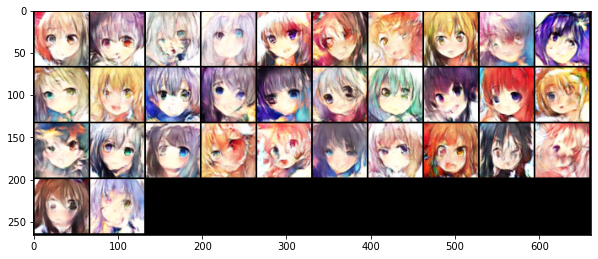

In [39]:
# Generate 1000 images and make a grid to save them.
n_output = 1000
z_sample = Variable(torch.randn(n_output, z_dim)).cuda()
imgs_sample = (G(z_sample).data + 1) / 2.0
log_dir = os.path.join(workspace_dir, 'logs')
filename = os.path.join(log_dir, 'result.jpg')
torchvision.utils.save_image(imgs_sample, filename, nrow=10)

# Show 32 of the images.
grid_img = torchvision.utils.make_grid(imgs_sample[:32].cpu(), nrow=10)
plt.figure(figsize=(10,10))
plt.imshow(grid_img.permute(1, 2, 0))
plt.show()

### Compress the generated images using **tar**.


In [40]:
# Save the generated images.
os.makedirs('output', exist_ok=True)
for i in range(1000):
    torchvision.utils.save_image(imgs_sample[i], f'output/{i+1}.jpg')
  
# Compress the images.
#%cd output
#!tar -zcf ../images.tgz *.jpg
#%cd ..